> __***** Projet 5 : Segmentation des clients d'un site E-commerce *****, Analyse exploratoire__

Ce projet consiste à explorer, visualiser et tester des approches de segmententation des clients.

Les commandes et la base de clients proviennent de l'ensemble de données public brésilien de commerce électronique de 100000 commandes effectuées sur  Olist Store au cours de la période 2016-2018, disponible sur le site Web de Kaggle . Ce sont de vraies données commerciales, avec des informations client anonymisées. Voici le schéma de base de données pour l'ensemble de données fourni:

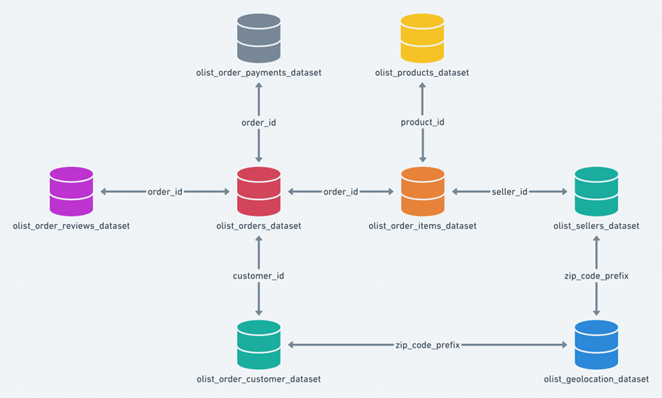

In [27]:
import pandas as pd
pd.options.plotting.backend = "plotly"

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import os
import plotly.express as px
import datetime

# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

print('### Brazilian E-Commerce Public Dataset by Olist ###')
for idx, file in enumerate(os.listdir('./Data/brazilian-ecommerce')):
    print(idx, '-', file)

### Brazilian E-Commerce Public Dataset by Olist ###
0 - olist_customers_dataset.csv
1 - olist_geolocation_dataset.csv
2 - olist_orders_dataset.csv
3 - olist_order_items_dataset.csv
4 - olist_order_payments_dataset.csv
5 - olist_order_reviews_dataset.csv
6 - olist_products_dataset.csv
7 - olist_sellers_dataset.csv
8 - product_category_name_translation.csv


# Chargement des données

In [29]:
# order items dataset
orders = pd.read_csv('./Data/brazilian-ecommerce/olist_orders_dataset.csv')
# order items dataset
items = pd.read_csv('./Data/brazilian-ecommerce/olist_order_items_dataset.csv')
# payment dataset
payment = pd.read_csv('./Data/brazilian-ecommerce/olist_order_payments_dataset.csv')
# product dataset
product = pd.read_csv('./Data/brazilian-ecommerce/olist_products_dataset.csv')
# customers items dataset
reviews = pd.read_csv('./Data/brazilian-ecommerce/olist_order_reviews_dataset.csv')

In [30]:
orders.shape

(99441, 8)

# Concaténation des bases de données

In [31]:
# orders merged with items
A = orders.merge(items, on='order_id', how='left')
# orders items merged with payment
B = A.merge(payment, on='order_id', how='left')
# orders_items_payment merged with product
C = B.merge(product, on='product_id', how='left')
# aggregation of review score by order_id
t1 = reviews.groupby("order_id").review_score.agg('mean')
x = t1.keys()
y = t1.values
review_agg = pd.DataFrame({'order_id' : x, 'review_score': y})
# orders_items_payment_product merged with review_agg
data = C.merge(review_agg, on='order_id', how='left')
data.describe()

,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,review_score
count,117604.000000,117604.000000,117604.000000,118431.000000,118431.000000,118431.000000,115906.000000,115906.000000,115906.000000,117584.000000,117584.000000,117584.00000,117584.000000,118434.000000
mean,1.195920,120.822849,20.045551,1.094207,2.937398,172.849395,48.767208,786.957302,2.207849,2114.281067,30.256872,16.63029,23.068394,3.999301
std,0.697721,184.477367,15.861351,0.728290,2.774164,268.259831,10.035162,653.029009,1.719519,3788.754048,16.190874,13.45878,11.748372,1.410705
min,1.000000,0.850000,0.000000,1.000000,0.000000,0.000000,5.000000,4.000000,1.000000,0.000000,7.000000,2.00000,6.000000,1.000000
25%,1.000000,39.900000,13.080000,1.000000,1.000000,60.860000,42.000000,347.000000,1.000000,300.000000,18.000000,8.00000,15.000000,3.000000
50%,1.000000,74.900000,16.290000,1.000000,2.000000,108.200000,52.000000,601.000000,1.000000,700.000000,25.000000,13.00000,20.000000,5.000000
75%,1.000000,134.900000,21.190000,1.000000,4.000000,189.245000,57.000000,985.000000,3.000000,1800.000000,38.000000,20.00000,30.000000,5.000000
max,21.000000,6735.000000,409.680000,29.000000,24.000000,13664.080000,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.00000,118.000000,5.000000


Le jeu de donnée de travail est le résultat d'une concaténation entre Order, Items, Payement, Product et Reviews. Il est constituée de :
- 27 variables 
- 117604 individus

# Traitement des données

## Processing of dates

- Transformation de date de commande en nombre de jours par rapport à la date la plus récente du dataset

In [32]:
# Returns a number of days equals to the timedelta between two dates given as string.


def get_number_of_days1(self, date_to):
    DATETIME_FORMAT = "%Y-%m-%d %H:%M:%S"
    from_dt = datetime.datetime.strptime(self, DATETIME_FORMAT)
    to_dt = datetime.datetime.strptime(date_to, DATETIME_FORMAT)
    timedelta = to_dt - from_dt
    diff_day = timedelta.days + float(timedelta.seconds) / 86400
    return int(diff_day)

In [33]:
data["order_purchase_on_days"] = data.order_purchase_timestamp.apply(get_number_of_days1, args=(data.order_purchase_timestamp.max(),))

- Création d'une nouvelle variable : le nombre de jours écoulés entre la date de commande et la date de livraison de la commande.

In [34]:
def get_number_of_days2(X):
    if str(X[1])=='nan'  :
        return 0
    else :
        """Returns a number of days equals to the timedelta between two dates given as string."""
        DATETIME_FORMAT = "%Y-%m-%d %H:%M:%S"
        from_dt = datetime.datetime.strptime(str(X[0]), DATETIME_FORMAT)
        to_dt = datetime.datetime.strptime(str(X[1]), DATETIME_FORMAT)
        timedelta = to_dt - from_dt
        diff_day = timedelta.days + float(timedelta.seconds) / 86400
        return diff_day

In [35]:
# data["order_approved_after_purchase"]=data[['order_purchase_timestamp','order_approved_at']].apply(get_number_of_days2,axis=1)
data["order_delivred_customer_after_purchase"] = data[['order_purchase_timestamp', 'order_delivered_customer_date']].apply(get_number_of_days2, axis=1)

In [36]:
# suppress of date features
data.drop(data[['order_purchase_timestamp', 'order_estimated_delivery_date', 'order_delivered_carrier_date', 'order_approved_at', 'order_delivered_customer_date', 'shipping_limit_date']], axis=1, inplace=True)

## Aggregations

L'objectif de ces agrégations est d'avoir à la fin une ligne par client

In [37]:
# group by customer_id and calculate the mean of payment_value
# le montant est la somme des achats
data['payment_value'] = data['payment_value'].fillna(0)
t1 = data.groupby("customer_id").payment_value.agg('sum')
x = t1.keys()
y = t1.values
DF = pd.DataFrame({'customer_id' : x, 'MonetaryValue': y})
DF.sort_values(by = "customer_id", ascending = False, inplace = True)

In [38]:
# group by customer_id and calculate the number of orders
# la fréquence
t2 = data["customer_id"].value_counts()
x = t2.keys()
y = t2.values
DF_temp = pd.DataFrame({'customer_id' : x, 'Frequency': y})
DF_temp.sort_values(by = "customer_id", ascending = False, inplace = True)
DF['Frequency'] = DF_temp['Frequency'].values

In [39]:
# group by customer_id and calculate the mean of order_purchase_on_days
# La récence
t2 = data.groupby("customer_id").order_purchase_on_days.agg('min')
x = t2.keys()
y = t2.values
DF_temp = pd.DataFrame({'customer_id' : x, 'Recency': y})
DF_temp.sort_values(by = "customer_id", ascending = False, inplace = True)
DF['Recency']=DF_temp['Recency'].values

In [40]:
# group by customer_id and calculate the mean of order_delivred_customer_after_purchase
t2 = data.groupby("customer_id").order_delivred_customer_after_purchase.agg('mean')
x = t2.keys()
y = t2.values
DF_temp = pd.DataFrame({'customer_id' : x, 'delay_livraison': y})
DF_temp.sort_values(by="customer_id", ascending = False, inplace = True)
DF['delay_livraison'] = DF_temp['delay_livraison'].values

In [41]:
# group by customer_id and calculate the mean of review_score
t2 = data.groupby("customer_id").review_score.agg('mean')
x = t2.keys()
y = t2.values
DF_temp = pd.DataFrame({'customer_id' : x, 'review_score': y})
DF_temp.sort_values(by = "customer_id", ascending = False, inplace = True)
DF['review_score'] = DF_temp['review_score'].values

# Les distributions des principales variables

In [42]:
cols = ['Recency']
fig = DF[cols].boxplot(title="Distribution de Recency")
fig.show()

In [43]:
cols = ['Frequency']
fig = DF[cols].boxplot(title="Distribution de Frequency")
fig.show()

In [44]:
cols = ['MonetaryValue']
fig = DF[cols].boxplot(title="Distribution de MonetaryValue")
fig.show()

In [45]:
cols = ['review_score']
fig = DF[cols].boxplot(title="Distribution de review_score")
fig.show()

In [46]:
cols = ['delay_livraison']
fig = DF[cols].boxplot(title="Distribution de delay_livraison")
fig.show()

# Génération du fichier data pour la segmentation

In [47]:
DF.to_csv('myFile_OLIST.csv', index=False)